In [1]:
!pip -q install openslide-python Pillow

In [2]:
# !conda install -y -c conda-forge openslide

In [3]:
!pip install openslide-python


In [4]:
import openslide
print(openslide.__version__)


1.4.1


In [5]:
import json
from multiprocessing import Process, JoinableQueue
import argparse
import os
import re
import shutil
import sys
import glob
import numpy as np
import math
from unicodedata import normalize
from skimage import io
from skimage.color import rgb2hsv
from skimage.util import img_as_ubyte
from skimage import filters
from PIL import Image, ImageFilter, ImageStat

Image.MAX_IMAGE_PIXELS = None

import openslide
from openslide import open_slide, ImageSlide
from openslide.deepzoom import DeepZoomGenerator

VIEWER_SLIDE_NAME = 'slide'

# PLOTTING IMAGES

In [6]:
PATH_BASE   = '/project/hnguyen2/hqvo3/Datasets/digital_pathology/public/CAMELYON16/images'
SLIDE_FORMAT = 'tif'

In [7]:
normal_paths = glob.glob(os.path.join(PATH_BASE, 'normal_*.' + SLIDE_FORMAT))
tumor_paths = glob.glob(os.path.join(PATH_BASE, 'tumor_*.' + SLIDE_FORMAT))

print(len(tumor_paths))
print(len(normal_paths))
 

111
159


In [8]:
import multiprocessing

# Get the number of CPU cores
num_cores = multiprocessing.cpu_count()
print(f'Number of CPU cores available: {num_cores}')

Number of CPU cores available: 40


In [9]:
import openslide
import matplotlib.pyplot as plt
import os

def plot_wsi_thumbnails(slide_paths, downsample_factor=0.01):
    """
    Function to plot thumbnails of WSI slides.

    Parameters:
    - slide_paths: List of file paths to WSI slides.
    - downsample_factor: Factor by which to downsample the WSI for faster plotting (default is 0.01).
    """
    # Create a plot with subplots (one for each WSI)
    num_slides = len(slide_paths)
    fig, axes = plt.subplots(1, num_slides, figsize=(20, 10))  # 1 row, n columns

    # Iterate over the slide paths and plot each thumbnail
    for i, slidepath in enumerate(slide_paths):
        slide = openslide.open_slide(slidepath)  # Open each WSI
        width, height = slide.dimensions  # Get WSI dimensions

        # Downsample the WSI for faster plotting
        new_width = int(width * downsample_factor)
        new_height = int(height * downsample_factor)

        # Generate a downsampled thumbnail
        plot_thumbnail = slide.get_thumbnail((new_width, new_height))

        # Plot the thumbnail in the i-th subplot
        axes[i].imshow(plot_thumbnail)
        axes[i].set_title(f"WSI {i+1} ({os.path.basename(slidepath)}, \n W, H = {width}, {height})")
        axes[i].axis('off')  # Hide axis for better visualization

    # Adjust layout and show the plot
    plt.tight_layout()
    plt.show()

# Example usage:

 

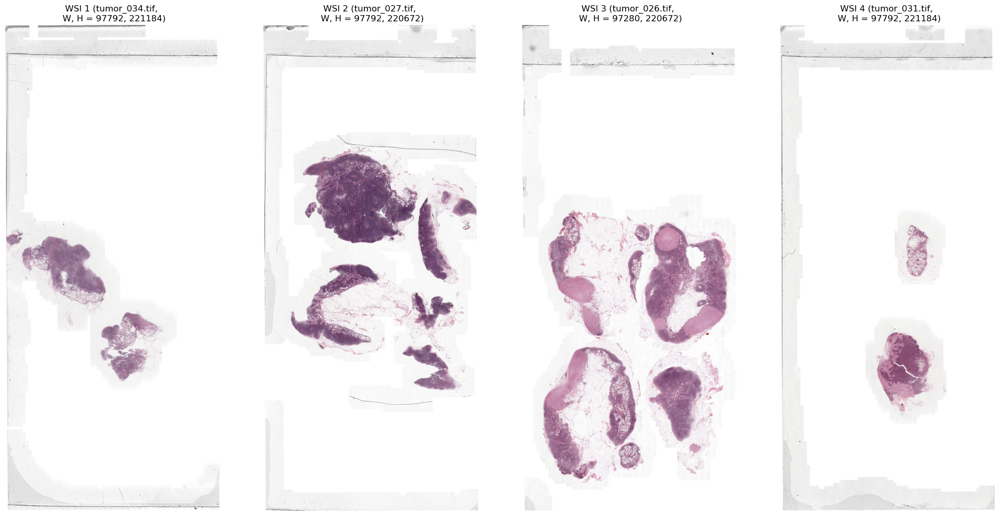

In [10]:
plot_wsi_thumbnails(tumor_paths[0:4], downsample_factor=0.01)

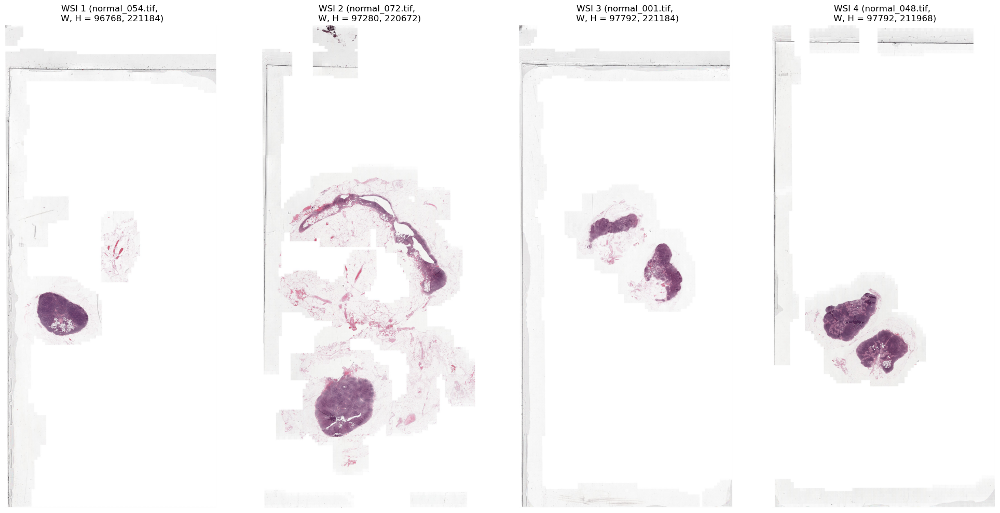

In [11]:
plot_wsi_thumbnails(normal_paths[0:4], downsample_factor=0.01)

# PLOT THE SIMULATION OF TILING

## UTIL PLOTTING

In [12]:
import os
import shutil

def create_or_recreate_folder(folder_name):
    if os.path.exists(folder_name):
        print(f"Folder '{folder_name}' already exists. Deleting and recreating.")
        shutil.rmtree(folder_name)  # Remove the folder and all its contents

    os.makedirs(folder_name)
    print(f"Folder '{folder_name}' has been created.")

In [13]:
import openslide  # OpenSlide library for reading WSI files
from PIL import Image, ImageFilter, ImageStat
import os
import numpy as np
import multiprocessing
from tqdm import tqdm
import time  # To measure execution time

def process_tile(img, left, top, tile_size, output_dir, tile_num, threshold):
    box = (left, top, left + tile_size, top + tile_size)
    tile = img.crop(box)  # Crop the image to the box

    edge = tile.filter(ImageFilter.FIND_EDGES)
    edge_stat = ImageStat.Stat(edge).sum
    edge_mean = np.mean(edge_stat) / (tile_size ** 2)

    if edge_mean > threshold:
        tile_filename = f"tile_{tile_num}.jpeg"
        tile_path = os.path.join(output_dir, tile_filename)
        tile.save(tile_path, "JPEG")

def down_sampling(slide, downsample_factor):
    width, height = slide.dimensions
    print(f"WSI original dimensions: {width} x {height}")

    new_width = int(width * downsample_factor)
    new_height = int(height * downsample_factor)
    thumbnail = slide.get_thumbnail((new_width, new_height))  # Get downsampled image
    print(f"Downsampled image dimensions: {new_width} x {new_height}")
    return thumbnail, new_width, new_height
# thumbnail, new_width, new_height = down_sampling(slide, downsample_factor)

def tiles_location_precomputed(
        thumbnail, new_hight, new_width, output_dir, tile_size):

    num_tiles_width = (new_width + tile_size - 1) // tile_size
    num_tiles_height = (new_height + tile_size - 1) // tile_size
    total_tiles_no_filtered = num_tiles_width * num_tiles_height

    tile_locations = []
    tile_args = []
    filtered_tile_count = 0

    for top in tqdm(range(0, new_height, tile_size), desc="Precomputing tiles"):
        for left in range(0, new_width, tile_size):
            box = (left, top, left + tile_size, top + tile_size)
            tile = thumbnail.crop(box)  # Crop the image to the box

            # Apply edge detection filter
            edge = tile.filter(ImageFilter.FIND_EDGES)
            edge_stat = ImageStat.Stat(edge).sum
            edge_mean = np.mean(edge_stat) / (tile_size ** 2)

            # Only keep the tile if it exceeds the edge detection threshold
            if edge_mean > edge_threshold:
                tile_locations.append((left, top))
                tile_args.append((thumbnail, left, top, tile_size, output_dir, filtered_tile_count, edge_threshold))
                filtered_tile_count += 1

    print(f"Total number of filtered tiles: {filtered_tile_count}")

    return tile_locations, tile_args, filtered_tile_count, total_tiles_no_filtered

def process_all_tiles(slide, output_dir, tile_size, downsample_factor, edge_threshold, num_workers):
    # Get the WSI dimensions at the largest level
    width, height = slide.dimensions
    print(f"WSI original dimensions: {width} x {height}")

    # Downsample the WSI for faster tiling
    new_width = int(width * downsample_factor)
    new_height = int(height * downsample_factor)
    thumbnail = slide.get_thumbnail((new_width, new_height))  # Get downsampled image
    print(f"Downsampled image dimensions: {new_width} x {new_height}")

    # Calculate the number of tiles to be created
    num_tiles_width = (new_width + tile_size - 1) // tile_size  # Tiles in width
    num_tiles_height = (new_height + tile_size - 1) // tile_size  # Tiles in height
    total_tiles = num_tiles_width * num_tiles_height
    # print(f"Total number of tiles to loop through: {total_tiles}")

    start = time.time()
    # Prepare the list of tiles to be processed
    tile_args = []
    tile_num = 0
    for top in range(0, new_height, tile_size):
        for left in range(0, new_width, tile_size):
            tile_args.append((thumbnail, left, top, tile_size, output_dir, tile_num, edge_threshold))
            tile_num += 1


    # Use multiprocessing to process tiles with 8 workers and display progress using tqdm
    with multiprocessing.Pool(num_workers) as pool:
        list(tqdm(pool.starmap(process_tile, tile_args), total=total_tiles))

    print(f"Processed {tile_num} tiles, saved in {output_dir}")


def plot_selected_tiles(slide, tile_locations, downsample_factor, tile_size, total_tiles_no_filtered):
    # Downsample the WSI again to use it for visualization
    width, height = slide.dimensions
    new_width = int(width * downsample_factor)
    new_height = int(height * downsample_factor)

    # Get the downsampled image
    thumbnail = slide.get_thumbnail((new_width, new_height))

    # Create a mask where tiles are selected
    mask = np.zeros((new_height, new_width), dtype=np.uint8)

    # Mark the selected tiles in the mask (setting those areas to 1)
    for left, top in tile_locations:
        left_downsampled = int(left)
        top_downsampled = int(top)
        mask[top_downsampled:top_downsampled+tile_size, left_downsampled:left_downsampled+tile_size] = 1

    # Plot the original image and the mask
    fig, ax = plt.subplots(1, 2, figsize=(15, 10))

    # Plot the downsampled image
    ax[0].imshow(thumbnail)
    ax[0].set_title(f"Downsampled Image ({total_tiles_no_filtered} total tiles)")

    # Plot the mask (with transparency)
    ax[1].imshow(thumbnail)
    ax[1].imshow(mask, cmap='jet', alpha=0.5)  # Overlay the mask on the image with transparency
    ax[1].set_title(f"Selected Tiles (filtered)")

    # Show the plots
    plt.tight_layout()
    plt.show()

 

In [14]:
def sliding_window_bboxes_in_tile_locations(tile_locations, tile_size, stride, downsample_factor, image_width, image_height):
    bboxes = []

    for left, top in tile_locations:
        # Ensure that the sliding window stays within the bounds of the tile's region
        for y in range(top, min(top + tile_size, image_height) - tile_size + 1, stride):
            for x in range(left, min(left + tile_size, image_width) - tile_size + 1, stride):
                # Downsample the coordinates
                left_downsampled = int(x * downsample_factor)
                top_downsampled = int(y * downsample_factor)

                # Append the bounding box (downsampled left, top, width, height)
                bbox = [left_downsampled, top_downsampled, int(tile_size * downsample_factor), int(tile_size * downsample_factor)]
                bboxes.append(bbox)

    return bboxes


## PLOTTING 

In [15]:
import time 

In [16]:
slidepath = tumor_paths[-1]  # Use the last slide in the lis


output_dir = "tiles_output"  # Directory to save the tiles
num_workers = 8  # Number of worker processes
downsample_factor = 0.1
edge_threshold = 10 

slide = openslide.open_slide(slidepath) 
base_name = os.path.basename(slidepath).split(".")[0]
output_dir = os.path.join(output_dir, base_name)
create_or_recreate_folder(output_dir)


Folder 'tiles_output/tumor_111' already exists. Deleting and recreating.
Folder 'tiles_output/tumor_111' has been created.


In [17]:
tile_size = 410 # because we are downsampling into 10%, original is 4096 

## Not Patching / tiling yet, just visualizing

### Visualize of patching using 4096 x 4096 on the image (this is downsampling into 10% to precompute) 

Folder 'tiles_output/tumor_111' already exists. Deleting and recreating.
Folder 'tiles_output/tumor_111' has been created.
WSI original dimensions: 97792 x 220672
Downsampled image dimensions: 9779 x 22067
thumnail size = (9779, 22067)
tile size = 410


Precomputing tiles: 100%|█████████████████████████████████████████████████████████████████████████████████████| 54/54 [00:04<00:00, 11.23it/s]


Total number of filtered tiles: 335
precompute time 4.814910173416138
Total tiles:  335
total_tiles_no_filtered 1296


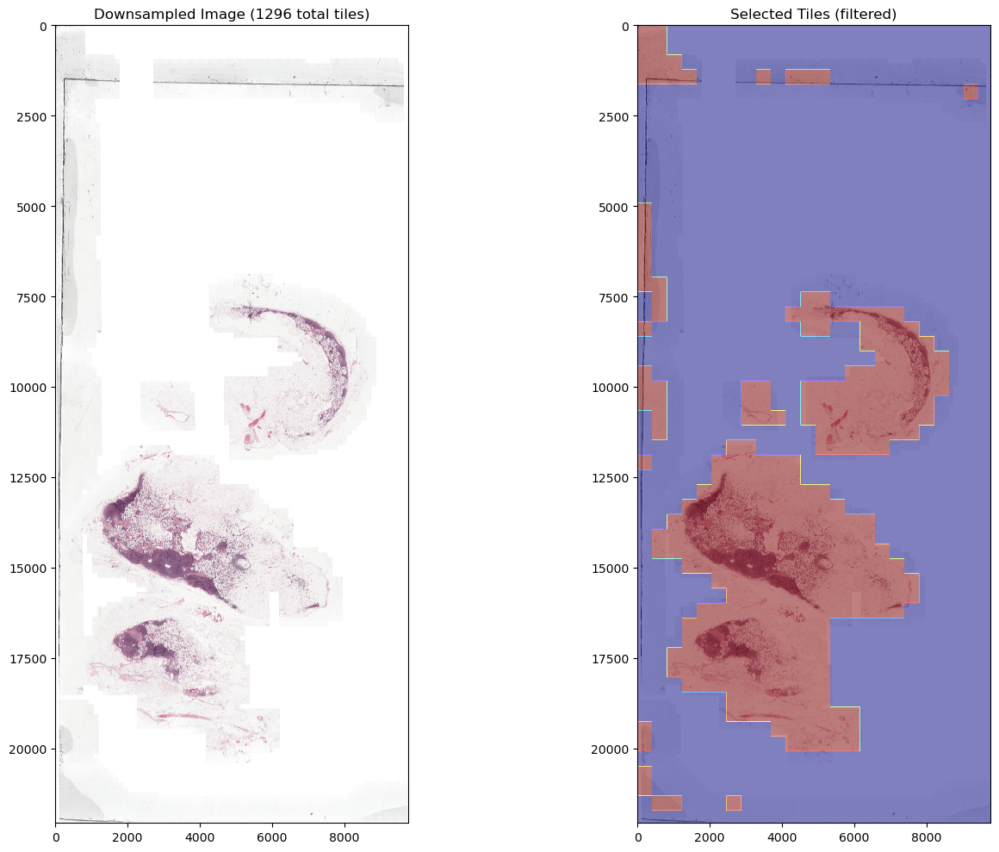

In [18]:
# process_all_tiles(slide, output_dir, tile_size, downsample_factor, edge_threshold, num_workers)
start = time.time()
slidepath = tumor_paths[-1]  # Use the last slide in the lis


output_dir = "tiles_output"  # Directory to save the tiles
num_workers = 8  # Number of worker processes
downsample_factor = 0.1
edge_threshold = 10 

slide = openslide.open_slide(slidepath) 
base_name = os.path.basename(slidepath).split(".")[0]
output_dir = os.path.join(output_dir, base_name)
create_or_recreate_folder(output_dir) 

tile_size = 410
thumbnail, new_width, new_height =  down_sampling(slide, downsample_factor)  
print(f"thumnail size = {thumbnail.size}") 
print(f"tile size = {tile_size}")



start = time.time()

tile_locations, tile_args, total_tiles, total_tiles_no_filtered = tiles_location_precomputed(
    thumbnail,
    new_height,
    new_width,
    output_dir,
    tile_size
    )
print("precompute time",  time.time() - start)

print("Total tiles: ", total_tiles)
print("total_tiles_no_filtered", total_tiles_no_filtered) 

plot_selected_tiles(slide, tile_locations, downsample_factor, tile_size, total_tiles_no_filtered)

Folder 'tiles_output/normal_160' already exists. Deleting and recreating.
Folder 'tiles_output/normal_160' has been created.
WSI original dimensions: 172032 x 93184
Downsampled image dimensions: 17203 x 9318
thumnail size = (17202, 9318)
tile size = 410


Precomputing tiles: 100%|█████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:03<00:00,  5.96it/s]


Total number of filtered tiles: 407
precompute time 3.8625285625457764
Total tiles:  407
total_tiles_no_filtered 966


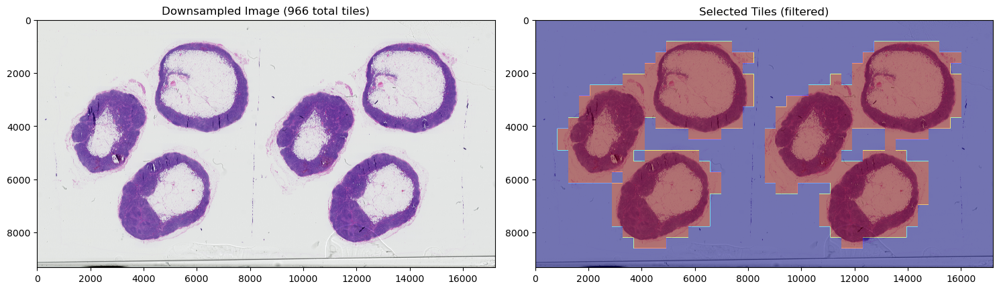

In [19]:
# process_all_tiles(slide, output_dir, tile_size, downsample_factor, edge_threshold, num_workers)
start = time.time()
slidepath = normal_paths[-1]  # Use the last slide in the lis


output_dir = "tiles_output"  # Directory to save the tiles
num_workers = 8  # Number of worker processes
downsample_factor = 0.1
edge_threshold = 10 

slide = openslide.open_slide(slidepath) 
base_name = os.path.basename(slidepath).split(".")[0]
output_dir = os.path.join(output_dir, base_name)
create_or_recreate_folder(output_dir) 

tile_size = 410
thumbnail, new_width, new_height =  down_sampling(slide, downsample_factor)  
print(f"thumnail size = {thumbnail.size}") 
print(f"tile size = {tile_size}")



start = time.time()

tile_locations, tile_args, total_tiles, total_tiles_no_filtered = tiles_location_precomputed(
    thumbnail,
    new_height,
    new_width,
    output_dir,
    tile_size
    )
print("precompute time",  time.time() - start)

print("Total tiles: ", total_tiles)
print("total_tiles_no_filtered", total_tiles_no_filtered) 

plot_selected_tiles(slide, tile_locations, downsample_factor, tile_size, total_tiles_no_filtered)

# Utils: Working with tiles image 

In [20]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

def sliding_window_bboxes_for_thumbnail(tile_locations, tile_size, stride, downsample_factor, image_width, image_height):
    """
    Apply a sliding window over the entire thumbnail image and return bounding boxes.
    Only return bounding boxes that overlap with tile locations.

    :param tile_locations: List of (left, top) coordinates for the tiles.
    :param tile_size: The size of the window (tile).
    :param stride: The step size between each window.
    :param downsample_factor: Factor by which to downsample the coordinates.
    :param image_width: The width of the original image.
    :param image_height: The height of the original image.
    :return: A list of bounding boxes (left, top, width, height) in the downsampled space.
    """
    bboxes = []

    # Sliding window over the entire thumbnail image
    for y in range(0, image_height - tile_size + 1, stride):
        for x in range(0, image_width - tile_size + 1, stride):
            # Downsample the coordinates
            left_downsampled = int(x * downsample_factor)
            top_downsampled = int(y * downsample_factor)

            # Define a bounding box for this window
            bbox = [left_downsampled, top_downsampled, int(tile_size * downsample_factor), int(tile_size * downsample_factor)]

            # Check if this window overlaps with any tile location
            for left_tile, top_tile in tile_locations:
                left_tile_downsampled = int(left_tile * downsample_factor)
                top_tile_downsampled = int(top_tile * downsample_factor)

                # Check if the current bbox overlaps with the tile location
                if (left_tile_downsampled <= left_downsampled < left_tile_downsampled + tile_size * downsample_factor) and \
                   (top_tile_downsampled <= top_downsampled < top_tile_downsampled + tile_size * downsample_factor):
                    bboxes.append(bbox)
                    break  # If overlap is found, no need to check other tiles for this bbox

    return bboxes

def plot_selected_tiles_optimized(thumbnail, bboxes, tile_size, total_tiles_no_filtered):
    """
    This function visualizes the bounding boxes of the selected tiles on the downsampled image.
    """
    fig, ax = plt.subplots(1, figsize=(12, 12))

    # Display the downsampled image
    ax.imshow(thumbnail)

    # Draw bounding boxes around the selected tiles
    for bbox in bboxes:
        left_downsampled, top_downsampled, box_width, box_height = bbox
        # Create a rectangle for each tile
        rect = patches.Rectangle((left_downsampled, top_downsampled), box_width, box_height,
                                 linewidth=1.5, edgecolor='r', facecolor='none')
        ax.add_patch(rect)

    ax.set_title(f"Selected Tiles Visualization ({total_tiles_no_filtered} total tiles)")
    plt.tight_layout()
    plt.show()

def crop_and_display_tiles(slide, random_bboxes, tile_size, downsample_factor):
    """
    Crop and display tiles based on the randomly selected bounding boxes.

    :param slide: The OpenSlide slide object.
    :param random_bboxes: List of randomly selected bounding boxes.
    :param tile_size: The size of each tile.
    :param downsample_factor: The factor used to downsample the original image.
    """
    fig, axes = plt.subplots(2, 5, figsize=(15, 6))  # Create a grid of 2 rows and 5 columns for 10 tiles

    for i, bbox in enumerate(random_bboxes):
        left_downsampled, top_downsampled, _, _ = bbox

        # Convert the downsampled coordinates back to the full-resolution coordinates
        left_original = int(left_downsampled / downsample_factor)
        top_original = int(top_downsampled / downsample_factor)

        # Crop the region from the original slide at the full resolution
        tile_region = slide.read_region((left_original, top_original), 0, (tile_size, tile_size))

        # Display the tile in the subplot
        ax = axes[i // 5, i % 5]  # Get the subplot
        ax.imshow(tile_region)
        ax.set_title(f"Tile {i+1}")
        ax.axis('off')  # Hide the axis

    plt.tight_layout()
    plt.show()

# Visualize the 10 randomly selected tiles


# Using 4096 x 4096 

In [21]:
image_width, image_height = slide.dimensions
print(image_width, image_height)

172032 93184


Folder 'tiles_output/normal_160' already exists. Deleting and recreating.
Folder 'tiles_output/normal_160' has been created.
WSI original dimensions: 172032 x 93184
Downsampled image dimensions: 17203 x 9318
thumnail size = (17202, 9318)


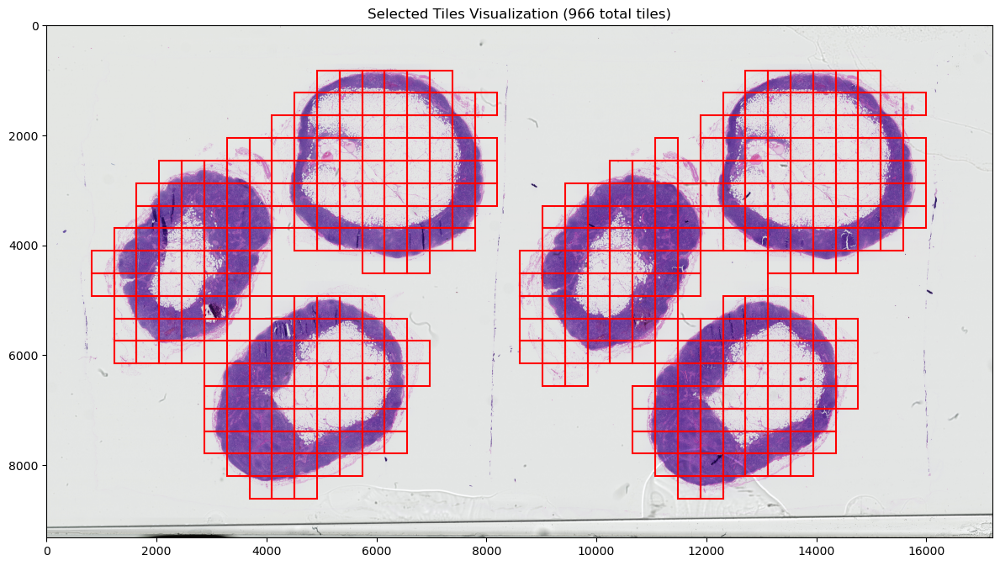

In [22]:
# thumbnail, new_width, new_height 
slidepath = normal_paths[-1]  # Use the last slide in the lis
output_dir = "tiles_output"  # Directory to save the tiles
num_workers = 8  # Number of worker processes
downsample_factor = 0.1
edge_threshold = 10 

slide = openslide.open_slide(slidepath) 
base_name = os.path.basename(slidepath).split(".")[0]
output_dir = os.path.join(output_dir, base_name)
create_or_recreate_folder(output_dir) 

tile_size = 410
thumbnail, new_width, new_height =  down_sampling(slide, downsample_factor)  
print(f"thumnail size = {thumbnail.size}")  


tile_size = 410  # Tile size for sliding window
stride = 410  # Step size for sliding window

bboxes = sliding_window_bboxes_in_tile_locations(
    tile_locations, tile_size, stride, 1, image_width, image_height)

# Visualize the result
plot_selected_tiles_optimized(thumbnail, bboxes, tile_size, total_tiles_no_filtered)

[[14350, 1640, 410, 410], [9840, 2870, 410, 410], [9430, 3690, 410, 410], [13940, 1230, 410, 410], [4920, 6970, 410, 410], [11070, 2050, 410, 410], [13530, 5740, 410, 410], [3690, 6970, 410, 410], [820, 4100, 410, 410], [3280, 6970, 410, 410]]


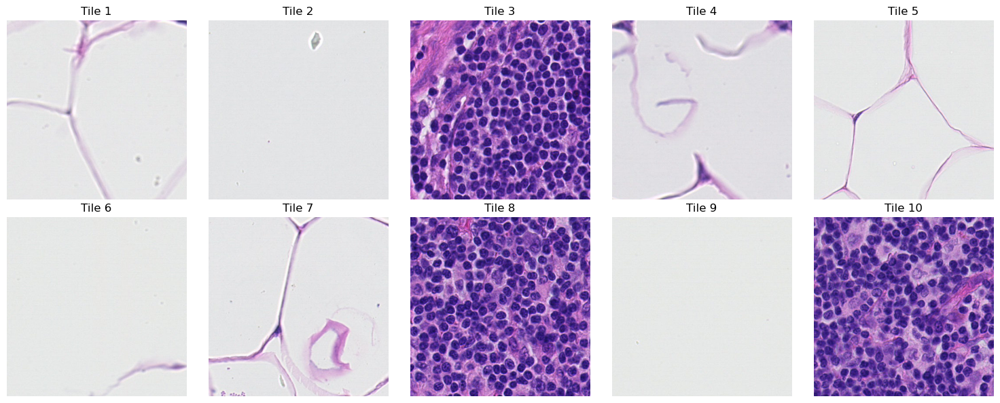

In [23]:
import random
random_bboxes = random.sample(bboxes, min(10, len(bboxes)))  # Ensure we don't select more than available bboxes 
print(random_bboxes)
crop_and_display_tiles(slide, random_bboxes, tile_size, downsample_factor)

# Apply the Sam on the whole structure of the image 

## Set up and utils 

In [24]:
import torch
import torchvision
print("PyTorch version:", torch.__version__)
print("Torchvision version:", torchvision.__version__)
print("CUDA is available:", torch.cuda.is_available())
import sys
!{sys.executable} -m pip install opencv-python matplotlib
!{sys.executable} -m pip install 'git+https://github.com/facebookresearch/sam2.git'

!mkdir -p images
!wget -P images https://raw.githubusercontent.com/facebookresearch/sam2/main/notebooks/images/cars.jpg

!mkdir -p ../checkpoints/
!wget -P ../checkpoints/ https://dl.fbaipublicfiles.com/segment_anything_2/092824/sam2.1_hiera_large.pt

PyTorch version: 2.5.1
Torchvision version: 0.20.1
CUDA is available: False
  Cloning https://github.com/facebookresearch/sam2.git to /tmp/pip-req-build-24g3fk2k
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/sam2.git /tmp/pip-req-build-24g3fk2k
  Resolved https://github.com/facebookresearch/sam2.git to commit 2b90b9f5ceec907a1c18123530e92e794ad901a4
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
--2024-12-18 07:40:08--  https://raw.githubusercontent.com/facebookresearch/sam2/main/notebooks/images/cars.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.110.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1058188 (1.0M) [image/jpeg]
Saving to: ‘images/cars.jpg.4’

cars.jpg.4      

In [25]:
import cv2 
# select the device for computation
if torch.cuda.is_available():
    device = torch.device("cuda")
elif torch.backends.mps.is_available():
    device = torch.device("mps")
else:
    device = torch.device("cpu")
print(f"using device: {device}")

if device.type == "cuda":
    # use bfloat16 for the entire notebook
    torch.autocast("cuda", dtype=torch.bfloat16).__enter__()
    # turn on tfloat32 for Ampere GPUs (https://pytorch.org/docs/stable/notes/cuda.html#tensorfloat-32-tf32-on-ampere-devices)
    if torch.cuda.get_device_properties(0).major >= 8:
        torch.backends.cuda.matmul.allow_tf32 = True
        torch.backends.cudnn.allow_tf32 = True
elif device.type == "mps":
    print(
        "\nSupport for MPS devices is preliminary. SAM 2 is trained with CUDA and might "
        "give numerically different outputs and sometimes degraded performance on MPS. "
        "See e.g. https://github.com/pytorch/pytorch/issues/84936 for a discussion."
    )

using device: cpu


In [26]:
def show_anns(anns, borders=True):
    """
    Generate an image with segmentation masks overlayed and optionally with borders.

    :param anns: List of annotations with 'segmentation' (binary mask) and 'area' (mask area).
    :param borders: Whether to draw borders around the masks (default True).
    :return: Annotated image with masks and optional borders.
    """
    if len(anns) == 0:
        return None  # No annotations to process
    
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    
    # Create a blank image with RGBA channaels (4th channel for transparency)
    img = np.ones((sorted_anns[0]['segmentation'].shape[0], sorted_anns[0]['segmentation'].shape[1], 4))
    img[:, :, 3] = 0  # Set the alpha (transparency) channel to 0 (fully transparent)
    
    for ann in sorted_anns:
        m = ann['segmentation']
        color_mask = np.concatenate([np.random.random(3), [0.5]])  # Random color with alpha
        img[m] = color_mask  # Apply the color to the mask regions
        
        if borders:
            contours, _ = cv2.findContours(m.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            # Smooth contours (optional)
            contours = [cv2.approxPolyDP(contour, epsilon=0.01, closed=True) for contour in contours]
            cv2.drawContours(img, contours, -1, (0, 0, 1, 0.4), thickness=1)  # Draw contour borders
    
    return img  # Return the annotated image

In [27]:
import torch
from torchvision import transforms
from PIL import Image

def down_sampling_sam(slide, downsample_factor):
    # Get the original dimensions of the WSI slide
    width, height = slide.dimensions
    print(f"WSI original dimensions: {width} x {height}")

    # Calculate the new dimensions based on the downsampling factor
    new_width = int(width * downsample_factor)
    new_height = int(height * downsample_factor)
    
    # Get the downsampled thumbnail from the slide
    thumbnail = slide.get_thumbnail((new_width, new_height))
    print(f"Downsampled image dimensions: {new_width} x {new_height}")
    
    # Convert the PIL image to a PyTorch tensor for SAM
    transform = transforms.Compose([
        transforms.ToTensor(),  # Converts the image to a tensor (C, H, W)
        # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalization (ImageNet stats)
    ])
    
    # Apply the transformations to the thumbnail
    image_tensor = transform(thumbnail)

    # Remove the batch dimension (SAM expects a single image, not a batch of images)
    image_tensor = image_tensor.permute(1, 2, 0).numpy()  # Convert from (C, H, W) to (H, W, C) numpy format
    image_numpy = np.clip(image_tensor * 255, 0, 255).astype(np.uint8)  
    return image_numpy, new_width, new_height 

## run SAM

In [28]:
from sam2.build_sam import build_sam2
from sam2.automatic_mask_generator import SAM2AutomaticMaskGenerator

sam2_checkpoint = "../checkpoints/sam2.1_hiera_large.pt"
model_cfg = "configs/sam2.1/sam2.1_hiera_l.yaml"

sam2 = build_sam2(model_cfg, sam2_checkpoint, device=device, apply_postprocessing=False)

# mask_generator = SAM2AutomaticMaskGenerator(sam2) 

mask_generator = SAM2AutomaticMaskGenerator(
    model=sam2,
    points_per_side=64,
    points_per_batch=128,
    pred_iou_thresh=0.7,
    stability_score_thresh=0.92,
    stability_score_offset=0.7,
    crop_n_layers=1,
    box_nms_thresh=0.7,
) 

# segmentation_output =  mask_generator.generate(image_tensor)
 

processing time: 342.17722606658936


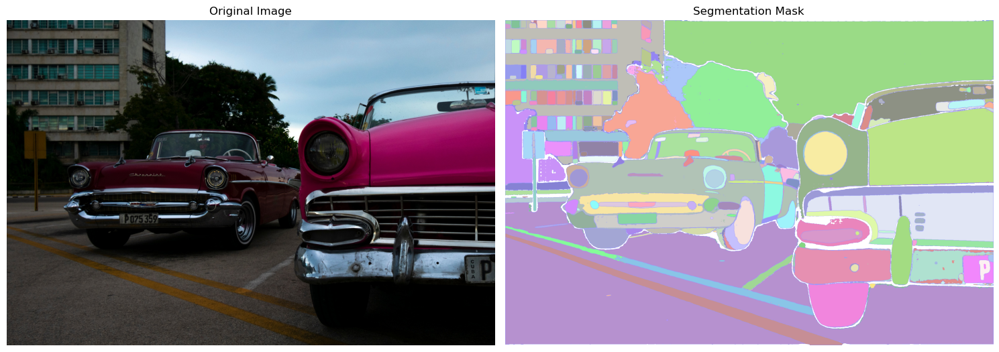

In [29]:
# Pass the numpy image to SAM model
image_path = "./images/cars.jpg"
image = Image.open(image_path) 
image = np.array(image.convert("RGB")) 
start = time.time()
segmentation_output = mask_generator.generate(image) 

mask_alone = show_anns(segmentation_output)

print("processing time:", time.time()-start) 
# Create subplots: one for the original image and one for the mask

plt.figure(figsize=(15, 10))

# Original image subplot
plt.subplot(1, 2, 1)
plt.imshow(image)
plt.title("Original Image")
plt.axis('off')  # Hide axis

# Segmentation mask subplot
plt.subplot(1, 2, 2)
plt.imshow(mask_alone)
plt.title("Segmentation Mask")
plt.axis('off')  # Hide axis

# Display the plots
plt.tight_layout()
plt.show()  

normal_158
WSI original dimensions: 147456 x 82432
Downsampled image dimensions: 1474 x 824
time processing sam: 273.4040446281433


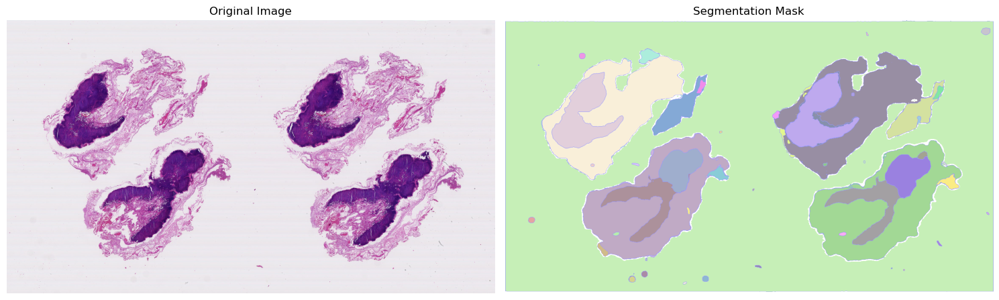

In [30]:
slidepath = normal_paths[-2]  # Use the last slide in the lis
downsample_factor = 0.01

slide = openslide.open_slide(slidepath) 
base_name = os.path.basename(slidepath).split(".")[0]

print(base_name) 
image_numpy, new_width, new_height =  down_sampling_sam(slide, downsample_factor)   

start = time.time()
segmentation_output =  mask_generator.generate(image_numpy)
print("time processing sam:", time.time()-start)  

mask_alone = show_anns(segmentation_output)
# Create subplots: one for the original image and one for the mask
plt.figure(figsize=(15, 10))

# Original image subplot
plt.subplot(1, 2, 1)
plt.imshow(image_numpy)
plt.title("Original Image")
plt.axis('off')  # Hide axis

# Segmentation mask subplot
plt.subplot(1, 2, 2)
plt.imshow(mask_alone)
plt.title("Segmentation Mask")
plt.axis('off')  # Hide axis

# Display the plots
plt.tight_layout()
plt.show() 

### Plotting Camelyon16

In [31]:
def plot_image_w_mask(mask_generator, slide_paths, downsample_factor=0.1, sam_threshold=0.2):
    """
    Function to plot images and their corresponding segmentation masks for multiple slides.
    
    :param slide_paths: List of paths to the slide images.
    :param downsample_factor: The factor by which to downsample the images.
    :param sam_threshold: The threshold for SAM mask generation.
    """
    # Create a figure with subplots
    num_slides = len(slide_paths)
    plt.figure(figsize=(15, num_slides * 5))  # Adjust height based on the number of slides
    
    for i, slidepath in enumerate(slide_paths):
        # Open slide and downsample it
        slide = openslide.open_slide(slidepath)
        base_name = os.path.basename(slidepath).split(".")[0]
        print(f"Processing slide: {base_name}")

        # Downsample the slide image
        image_numpy, new_width, new_height = down_sampling_sam(slide, downsample_factor)
        
        # Generate the segmentation mask using SAM
        start = time.time()
        segmentation_output = mask_generator.generate(image_numpy)
        print(f"Time processing SAM for {base_name}: {time.time() - start:.2f} seconds")

        # Create the mask alone (segmentation mask)
        mask_alone = show_anns(segmentation_output)

        # Create subplots: one for the original image and one for the mask
        plt.subplot(num_slides, 2, 2 * i + 1)
        plt.imshow(image_numpy)
        plt.title(f"Original Image: {base_name}")
        plt.axis('off')  # Hide axis

        # Segmentation mask subplot
        plt.subplot(num_slides, 2, 2 * i + 2)
        plt.imshow(mask_alone)
        plt.title(f"Segmentation Mask: {base_name}")
        plt.axis('off')  # Hide axis

    # Adjust layout and show the plots
    plt.tight_layout()
    plt.show()

Threshold 0.7

Processing slide: normal_160
WSI original dimensions: 172032 x 93184
Downsampled image dimensions: 1720 x 931
Time processing SAM for normal_160: 252.48 seconds
Processing slide: normal_158
WSI original dimensions: 147456 x 82432
Downsampled image dimensions: 1474 x 824
Time processing SAM for normal_158: 276.65 seconds
Processing slide: normal_159
WSI original dimensions: 118784 x 86016
Downsampled image dimensions: 1187 x 860
Time processing SAM for normal_159: 264.45 seconds
Processing slide: normal_157
WSI original dimensions: 114688 x 96768
Downsampled image dimensions: 1146 x 967
Time processing SAM for normal_157: 266.60 seconds
Processing slide: normal_156
WSI original dimensions: 102400 x 82432
Downsampled image dimensions: 1024 x 824
Time processing SAM for normal_156: 262.51 seconds


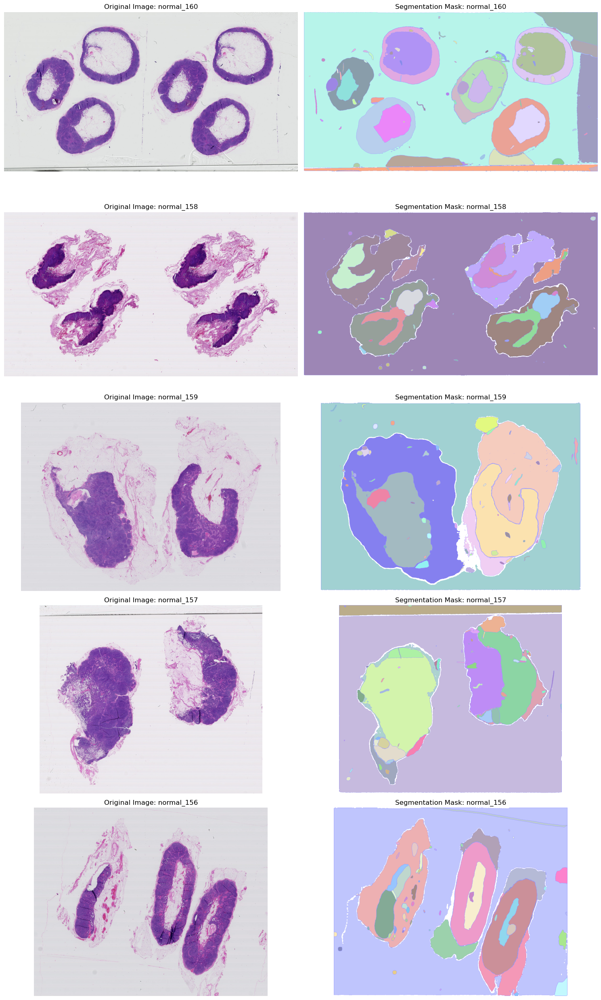

In [32]:
slide_paths = [normal_paths[-1], normal_paths[-2], normal_paths[-3], normal_paths[-4], normal_paths[-5]] 

plot_image_w_mask(mask_generator, slide_paths, downsample_factor=0.01)


# Adjustment to capture more smaller object! 

In [33]:
# mask_generator_2 = SAM2AutomaticMaskGenerator(
#     model=sam2, #Intersection over Union (IoU) between the predicted masks and ground truth masks 
#     points_per_side=128, # to sample more points, which can help detect finer details 
#     points_per_batch=256, #  ill allow more points to be processed in parallel, potentially speeding up the process. 
#     pred_iou_thresh=0.5, 
#     stability_score_thresh=0.85, #How confident the model has to be in the mask before accepting it. The lower the threshold, the more masks are accepted, including those with lower confidence, which could be useful for detecting small objects.  
#     stability_score_offset=0.5, 
#     crop_n_layers=2, # how many layers of cropping the model should perform when processing large images, especially those with high resolution 
#     box_nms_thresh=0.1, # parameter controls the threshold for deciding when two bounding boxes overlap too much and one should be discarded. 
# ) 
#   #downsample_factor = 0.5 

In [34]:
# # 18h 28 
# mask_generator = SAM2AutomaticMaskGenerator(
#     model=sam2,
#     points_per_side=64,
#     points_per_batch=128,
#     pred_iou_thresh=0.7,
#     stability_score_thresh=0.92,
#     stability_score_offset=0.7,
#     crop_n_layers=1,
#     box_nms_thresh=0.7,
# ) 


In [35]:
# => larger image take a long time to run (15 mins 1 anh3 can 
# slide_paths = [normal_paths[-1], normal_paths[-2]] 

# plot_image_w_mask(mask_generator, slide_paths, downsample_factor=0.05)


In [36]:
# slide_paths = [tumor_paths[-1], tumor_paths[-2]] 

# plot_image_w_mask(mask_generator_2, slide_paths, downsample_factor=0.01)


In [37]:
# slide_paths = [normal_paths[-1], normal_paths[-2]] 

# plot_image_w_mask(mask_generator_2, slide_paths, downsample_factor=0.05)


## Utils: Segmentation next level

In [38]:
import os

def create_directory(dir_path):
    if not os.path.exists(dir_path):
        os.makedirs(dir_path)
        print(f"Directory '{dir_path}' created.")
    else:
        print(f"Directory '{dir_path}' already exists.")


output_dir = "output_segments"
create_directory(output_dir)


Directory 'output_segments' already exists.


In [39]:
def extract_and_save_segments(image, segmentation_output, output_dir="output_segments"):
    """
    Extracts individual segments from the segmentation output and saves them as separate images.
    
    :param image: The original image (numpy array).
    :param segmentation_output: List of segmentations with 'segmentation' (binary mask) and 'area' (mask area).
    :param output_dir: Directory to save individual segment images.
    """
    # Ensure the output directory exists
    create_directory(output_dir)
    
    segment_count = 0
    for idx, seg_info in enumerate(segmentation_output):
        # Extract the segmentation mask for this object
        mask = seg_info['segmentation']
        
        # Create a blank image with the same dimensions as the original
        segment_image = np.zeros_like(image)
        
        # Apply the mask to the original image (keep only the pixels that belong to the current segment)
        segment_image[mask] = image[mask]
        
        # Save the individual segment as an image
        segment_filename = os.path.join(output_dir, f"segment_{idx+1}.png")
        plt.imsave(segment_filename, segment_image)  # Save the image as PNG
        print(f"Saved segment {idx+1} to {segment_filename}")
        
        segment_count += 1

    print(f"Extracted {segment_count} segments and saved them as images.") 

In [40]:
import matplotlib.image as mpimg
 
def plot_first_n_segments(output_dir, n=10):
    """
    Plots the first n segments from the saved segment images.

    :param output_dir: Directory containing the saved segment images.
    :param n: Number of segments to plot (default is 10).
    """
    # Get all segment files from the output directory
    segment_files = [f for f in os.listdir(output_dir) if f.startswith("segment_") and f.endswith(".png")]
    
    # Sort the files to ensure they are in order
    segment_files.sort()
    
    # Plot the first n segments
    plt.figure(figsize=(15, 10))
    
    for i, segment_file in enumerate(segment_files[:n]):
        # Load the image
        img = mpimg.imread(os.path.join(output_dir, segment_file))
        
        # Plot the image
        plt.subplot(2, 5, i + 1)  # Arrange in 2 rows and 5 columns
        plt.imshow(img)
        plt.title(f"Segment {i+1}")
        plt.axis('off')  # Hide the axis
    
    plt.tight_layout()
    plt.show()



In [41]:
def crop_image_using_bbox(image, crop_box):
    xmin, ymin, width, height = crop_box
    xmax = xmin + width
    ymax = ymin + height

    # Crop the image using numpy array slicing
    cropped_image = image[ymin:ymax, xmin:xmax]
    
    return cropped_image

In [42]:
def apply_mask_and_crop(image, segmentation_info):
    # Extract segmentation mask and crop box
    mask = segmentation_info['segmentation']  # Binary mask (True for object, False for background)
    bbox = segmentation_info['bbox']  # [xmin, ymin, width, height]
    
    # Convert crop box values to integers
    xmin, ymin, width, height = map(int, bbox)
    xmax = xmin + width
    ymax = ymin + height
    
    # Apply the mask to the image (set the background to black)
    masked_image = np.zeros_like(image)
    masked_image[mask] = image[mask]
    
    # Crop the image using the crop_box [xmin, ymin, width, height]
    cropped_image = masked_image[ymin:ymax, xmin:xmax]
    
    return cropped_image
 

In [55]:
def apply_mask_and_crop_original(image, segmentation_info, downsample_factor=0.01):
    mask = segmentation_info['segmentation']  # Binary mask (True for object, False for background)
    bbox = segmentation_info['bbox']  # [xmin, ymin, width, height]
    
    # Resize the mask to match the image size using nearest neighbor interpolation (binary mask)
    mask_resized = cv2.resize(mask.astype(np.uint8), (image.shape[1], image.shape[0]), interpolation=cv2.INTER_NEAREST)
    
    # Rescale the bbox to the original image size
    xmin, ymin, width, height = bbox
    xmin_original = int(xmin / downsample_factor)
    ymin_original = int(ymin / downsample_factor)
    width_original = int(width / downsample_factor)
    height_original = int(height / downsample_factor)
    
    # Compute the relative bounding box
    relative_bbox = [xmin_original, ymin_original, width_original, height_original]
    
    # Apply the mask to the original image (set the background to black)
    masked_image = np.zeros_like(image, dtype=np.uint8)  # Create an empty image (background is black)
    masked_image[mask_resized == 1] = image[mask_resized == 1]  # Apply the mask (keep only the regions of interest)
    
    # Crop the image using the rescaled bbox
    xmax_original = xmin_original + width_original
    ymax_original = ymin_original + height_original
    cropped_image = masked_image[ymin_original:ymax_original, xmin_original:xmax_original]
    
    return cropped_image, relative_bbox 


In [44]:
def plot_multiple_images(segmentation_output, image_numpy, downsample_factor=0.01, rows=3, cols=3):
    plt.figure(figsize=(15, 10))
    
    for idx, seg_info in enumerate(segmentation_output[:rows * cols]):
        # Apply the mask and crop the image for each segmentation output
        cropped_image_with_mask, _ = apply_mask_and_crop_original(image_numpy, seg_info, downsample_factor)
        
        # Plot the cropped image with mask
        plt.subplot(rows, cols, idx + 1)  # Define the subplot position
        plt.imshow(cropped_image_with_mask)
        plt.title(f"Segment {idx+1}")  # Title with segment index
        plt.axis('off')  # Hide axis
    
    plt.tight_layout()
    plt.show()

## plotting

In [45]:
slidepath = normal_paths[-3]  # Use the last slide in the lis
downsample_factor = 0.1 

slide = openslide.open_slide(slidepath) 
base_name = os.path.basename(slidepath).split(".")[0]

print(base_name) 
image_numpy_010, _, _ =  down_sampling_sam(slide, downsample_factor)   

normal_159
WSI original dimensions: 118784 x 86016
Downsampled image dimensions: 11878 x 8601


In [46]:

segmentation_output[0]


{'segmentation': array([[False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        ...,
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False]]),
 'area': 25538,
 'bbox': [964.0, 405.0, 318.0, 273.0],
 'predicted_iou': 0.9315575957298279,
 'point_coords': [[1165.6796875, 517.8125]],
 'stability_score': 0.9386018514633179,
 'crop_box': [597.0, 272.0, 877.0, 552.0]}

In [47]:
segmentation_output[0]['crop_box']

[597.0, 272.0, 877.0, 552.0]

In [48]:
# idx = 0
# cropped_image_with_mask = apply_mask_and_crop(image_numpy, segmentation_output[0])
# plt.figure(figsize=(8, 8))
# plt.imshow(cropped_image_with_mask)
# plt.title("{idx}")
# plt.axis('off')  # Hide axis
# plt.show() 

In [49]:
# cropped_image_with_mask, relative_bbox = apply_mask_and_crop_original(image_numpy_010, segmentation_output[0], downsample_factor=0.1)
# plt.imshow(cropped_image_with_mask) 

In [68]:
image_numpy_010, _, _ =  down_sampling_sam(slide, 0.1)    


WSI original dimensions: 118784 x 86016
Downsampled image dimensions: 11878 x 8601


normal_159
WSI original dimensions: 118784 x 86016
Downsampled image dimensions: 1187 x 860
WSI original dimensions: 118784 x 86016
Downsampled image dimensions: 1187 x 860
time processing sam: 271.13676929473877


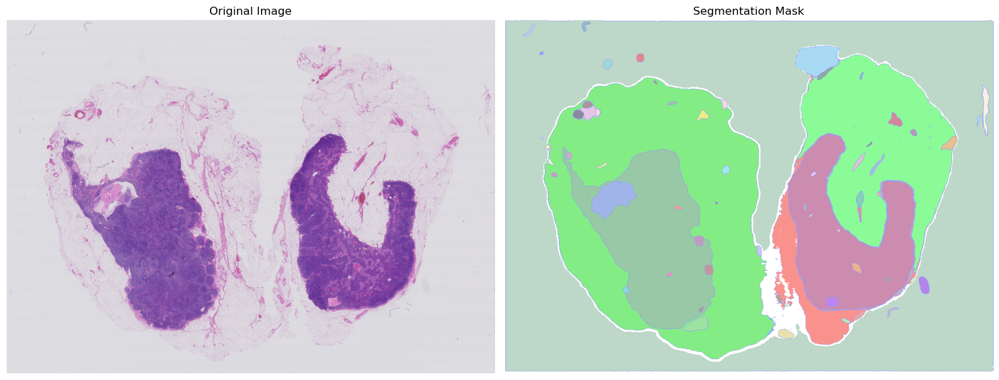

In [50]:
slidepath = normal_paths[-3]  # Use the last slide in the lis
downsample_factor = 0.01

slide = openslide.open_slide(slidepath) 
base_name = os.path.basename(slidepath).split(".")[0]

print(base_name) 
image_numpy, new_width, new_height =  down_sampling_sam(slide, downsample_factor)   
start = time.time()
segmentation_output =  mask_generator.generate(image_numpy)
print("time processing sam:", time.time()-start)  

mask_alone = show_anns(segmentation_output) 
plt.figure(figsize=(15, 10))

# Original image subplot
plt.subplot(1, 2, 1)
plt.imshow(image_numpy)
plt.title("Original Image")
plt.axis('off')  # Hide axis

# Segmentation mask subplot
plt.subplot(1, 2, 2)
plt.imshow(mask_alone)
plt.title("Segmentation Mask")
plt.axis('off')  # Hide axis

# Display the plots
plt.tight_layout()
plt.show() 

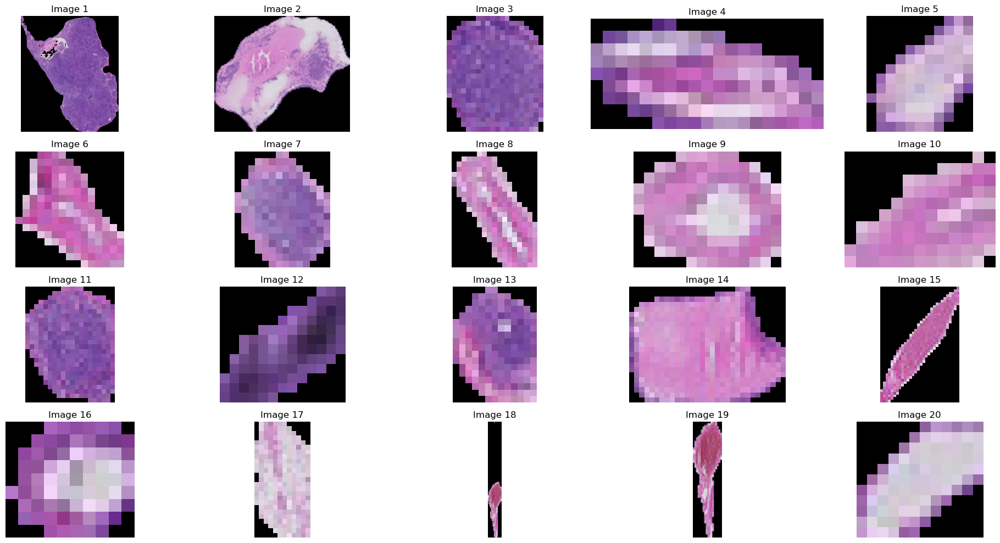

In [51]:

fig, axes = plt.subplots(4, 5, figsize=(20, 10))  # 2 rows, 5 columns

for idx in range(20):
    cropped_image_with_mask = apply_mask_and_crop(image_numpy, segmentation_output[idx])
    
    ax = axes[idx // 5, idx % 5]
    ax.imshow(cropped_image_with_mask)
    ax.set_title(f"Image {idx + 1}")
    ax.axis('off')  # Hide axis

plt.tight_layout()
plt.show()  

crop on downsampling X0.1

Number of segments in image: 73


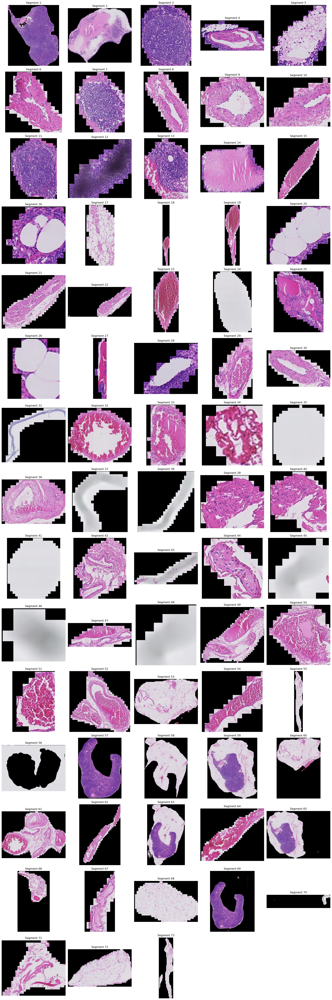

In [69]:

print("Number of segments in image:", len(segmentation_output))

num_segments = len(segmentation_output)
cols = 5  
rows = (num_segments // cols) + (1 if num_segments % cols != 0 else 0)  # Calculate rows based on number of segments
fig, axes = plt.subplots(rows, cols, figsize=(20, 4 * rows))  # Create subplots
axes = axes.flatten()

for idx in range(num_segments):
    cropped_image_with_mask, relative_bbox = apply_mask_and_crop_original(image_numpy_010, segmentation_output[idx], downsample_factor=0.1)
    
    ax = axes[idx]  # Get the correct subplot
    ax.imshow(cropped_image_with_mask)
    ax.set_title(f"Segment {idx + 1}")
    ax.axis('off')  # Hide axis

for idx in range(num_segments, len(axes)):
    axes[idx].axis('off')

plt.tight_layout()
plt.show()  
 

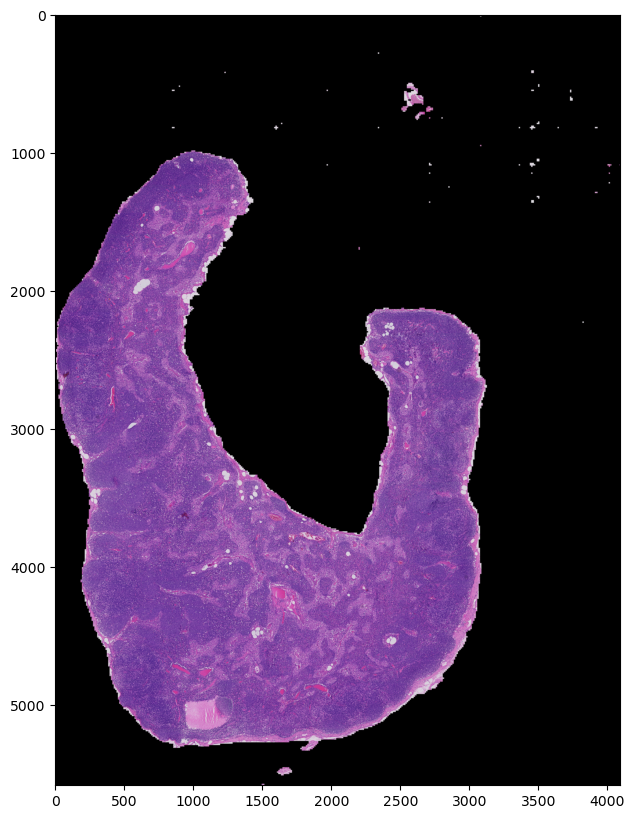

In [70]:
idx = 69
cropped_image_with_mask, _ = apply_mask_and_crop_original(image_numpy_010, segmentation_output[idx-1], downsample_factor=0.1)
fig = plt.figure(figsize=(10, 10)) 
plt.imshow(cropped_image_with_mask)  

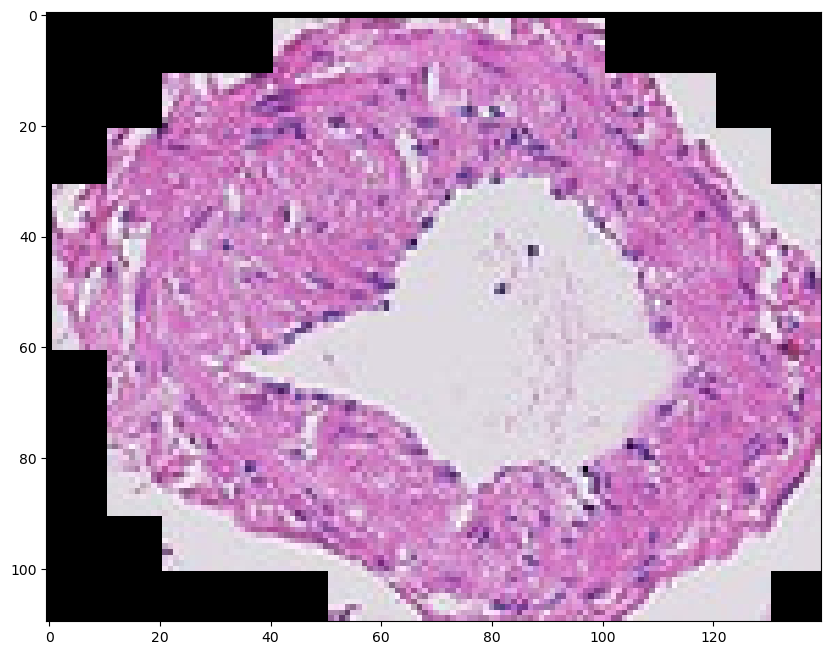

In [71]:
idx = 9
cropped_image_with_mask, _ = apply_mask_and_crop_original(image_numpy_010, segmentation_output[idx-1], downsample_factor=0.1)
fig = plt.figure(figsize=(10, 10)) 
plt.imshow(cropped_image_with_mask)  

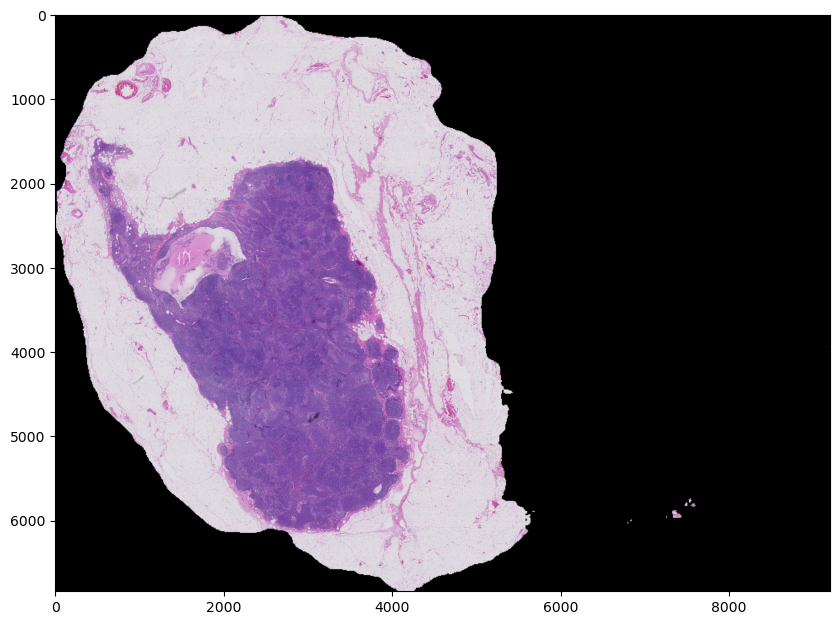

In [72]:
idx = 65
cropped_image_with_mask, _ = apply_mask_and_crop_original(image_numpy_010, segmentation_output[idx-1], downsample_factor=0.1)
fig = plt.figure(figsize=(10, 10)) 
plt.imshow(cropped_image_with_mask)  

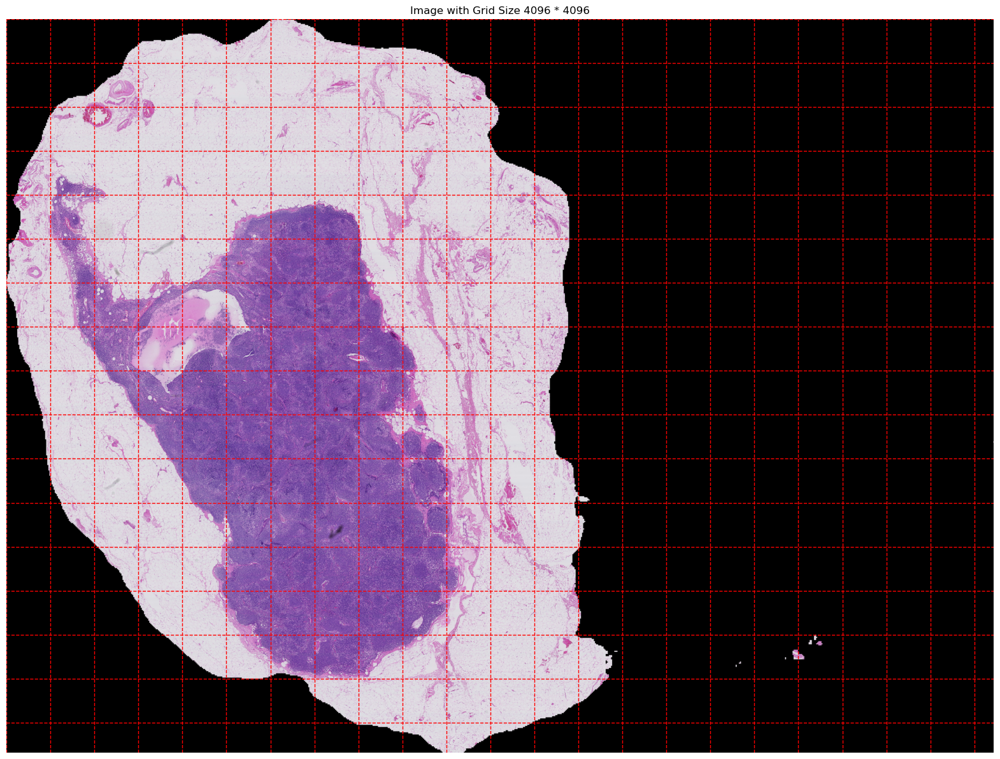

In [75]:
a = 410  # Grid cell size (e.g., 410 pixels)
image_height, image_width = cropped_image_with_mask.shape[:2]  # Get image dimensions

# Create the plot
fig = plt.figure(figsize=(20, 20))
plt.imshow(cropped_image_with_mask)

# Add grid lines
for x in range(0, image_width, a):
    plt.axvline(x=x, color='r', linestyle='--', linewidth=1)  # Vertical lines
for y in range(0, image_height, a):
    plt.axhline(y=y, color='r', linestyle='--', linewidth=1)  # Horizontal lines

plt.title(f"Image with Grid Size 4096 * 4096")
plt.axis('off')  # Hide axis for better presentation
plt.show() 

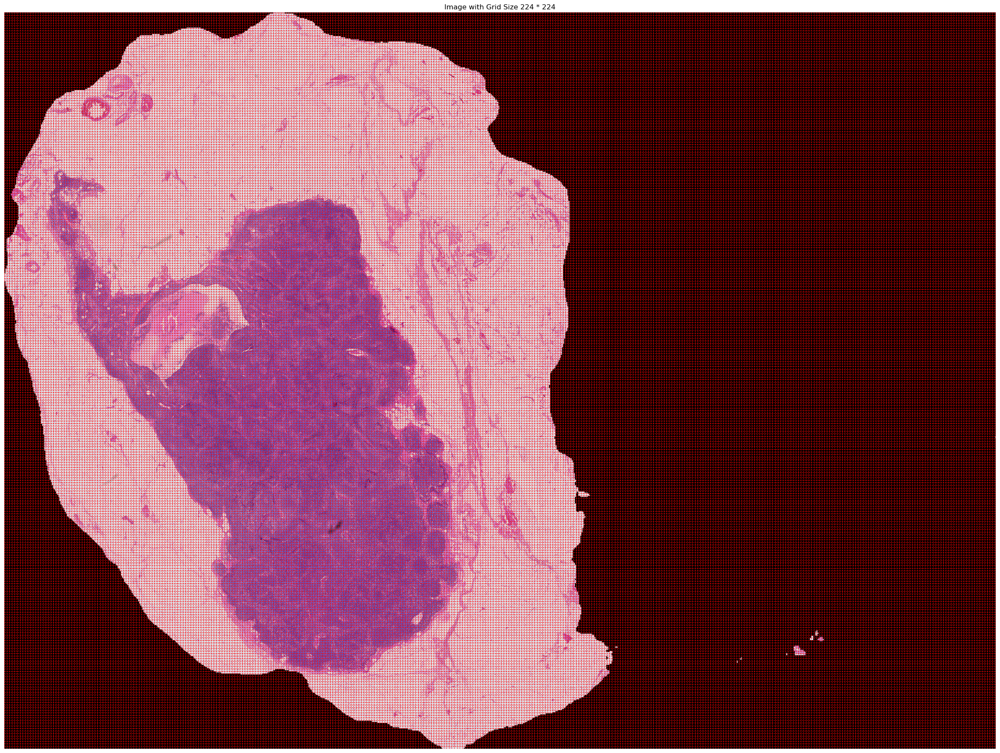

In [76]:
a = 24  # Grid cell size (e.g., 410 pixels)
image_height, image_width = cropped_image_with_mask.shape[:2]  # Get image dimensions

# Create the plot
fig = plt.figure(figsize=(30, 30))
plt.imshow(cropped_image_with_mask)

# Add grid lines
for x in range(0, image_width, a):
    plt.axvline(x=x, color='r', linestyle='--', linewidth=0.7)  # Vertical lines
for y in range(0, image_height, a):
    plt.axhline(y=y, color='r', linestyle='--', linewidth=0.7)  # Horizontal lines

plt.title(f"Image with Grid Size 224 * 224")
plt.axis('off')  # Hide axis for better presentation
plt.show() 